In [ ]:
#!pip install datatorch

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Foi utilizado um método mais rápido para instalação do detectron2 mas não contém todas as suas funcionalidades.
!git clone 'https://github.com/facebookresearch/detectron2'
# O comando Git clone irá fazer o download de um repositório do github chamado "Detectron2" que contém o código fonte.
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

In [ ]:
import torch, detectron2
#Exibe versões da placa de vídeo,CUDA,torch e detectron2.
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.1 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# Importação de bibliotecas básicas e do detectron2
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
#O comando wget vai fazer o download de um arquivo compactado e o unzip vai descompactar.
!wget https://github.com/cassiomatos92/data/archive/refs/heads/data.zip
!unzip data.zip > /dev/null

--2023-12-06 23:50:26--  https://github.com/cassiomatos92/data/archive/refs/heads/data.zip
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/cassiomatos92/data/zip/refs/heads/data [following]
--2023-12-06 23:50:27--  https://codeload.github.com/cassiomatos92/data/zip/refs/heads/data
Resolving codeload.github.com (codeload.github.com)... 140.82.121.9
Connecting to codeload.github.com (codeload.github.com)|140.82.121.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘data.zip’

data.zip                [    <=>             ] 233.65M  22.5MB/s    in 11s     

2023-12-06 23:50:38 (22.1 MB/s) - ‘data.zip’ saved [245003549]



In [ ]:
# Será atribuído um nome para o nosso conjunto de dados. Abaixo também pode se encontrar os caminhos para a pasta onde o arquivo .json está e as fotos usadas para criação do dataset.
from detectron2.data.datasets import register_coco_instances
register_coco_instances("fruits_nuts", {}, "./data-data/trainval.json", "./data-data/images")

In [ ]:
# Acessando os metadados do conjunto de dados que registramos a cima
fruits_nuts_metadata = MetadataCatalog.get("fruits_nuts")
dataset_dicts = DatasetCatalog.get("fruits_nuts")

[12/06 23:50:47 d2.data.datasets.coco]: Loaded 33 images in COCO format from ./data-data/trainval.json


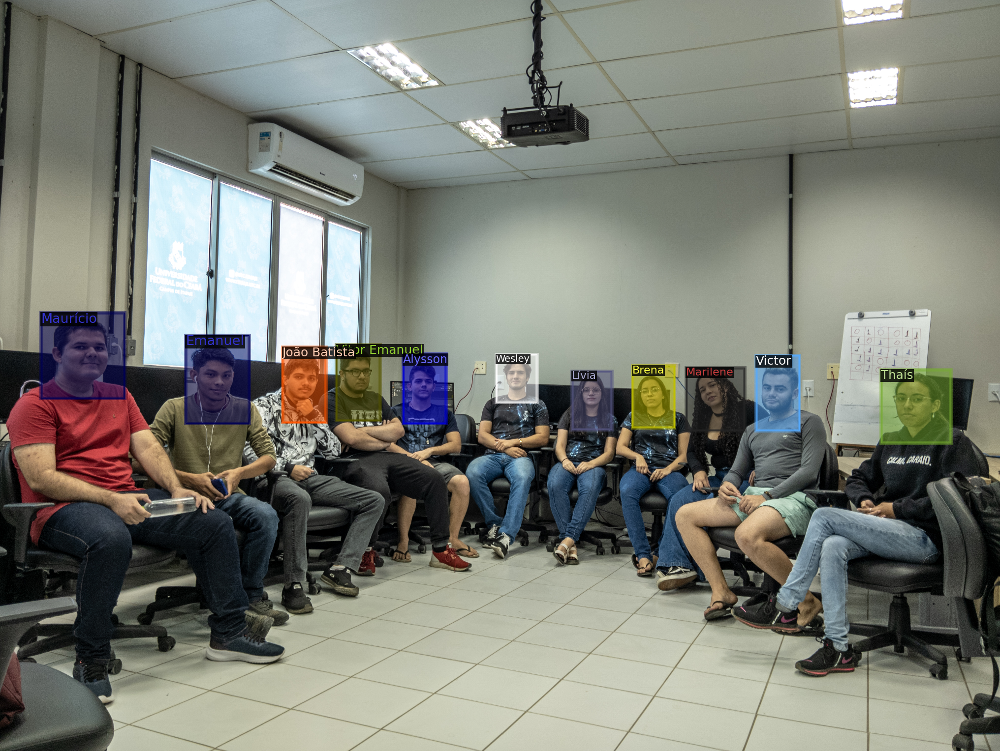

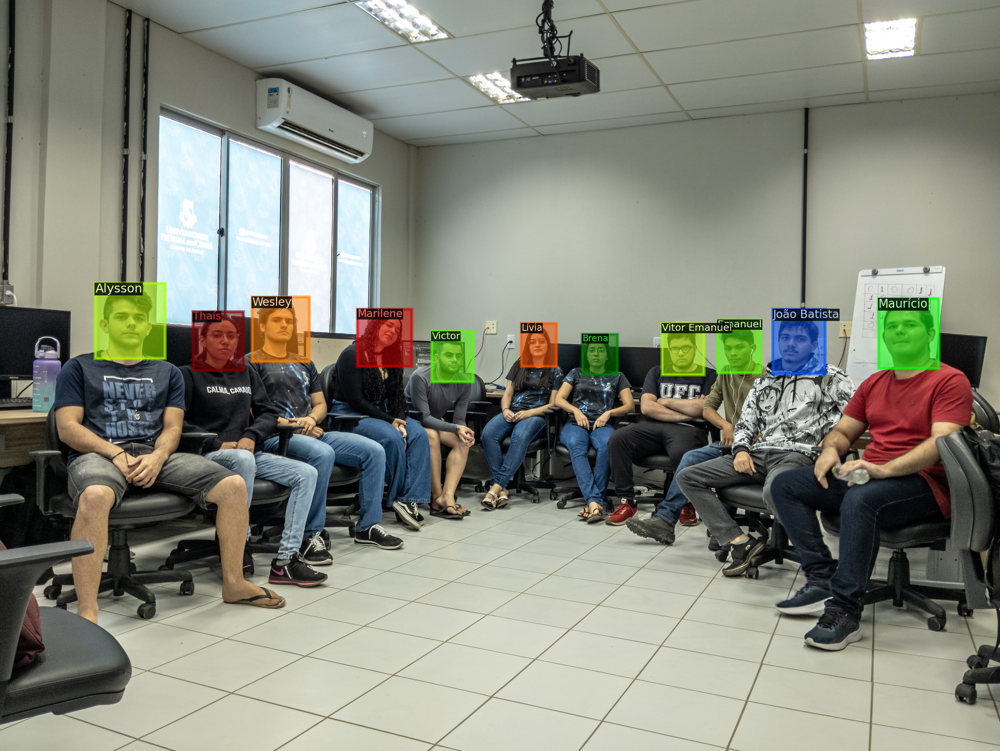

In [ ]:
# O random vai escolher 2 fotos aleatórias e apresentar ela com os nomes que foram definidos no dataset
import random

for d in random.sample(dataset_dicts, 2):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=fruits_nuts_metadata, scale=0.5)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
#Nessa célula será realizado o treinamento do modelo de detecção dos rostos
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file("./detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("fruits_nuts",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = 700
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/06 23:51:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:00, 196MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/06 23:51:52 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/06 23:52:27 d2.utils.events]:  eta: 0:13:47  iter: 19  total_loss: 3.274  loss_cls: 1.691  loss_box_reg: 0.7603  loss_mask: 0.6826  loss_rpn_cls: 0.1118  loss_rpn_loc: 0.07206    time: 1.2681  last_time: 1.2301  data_time: 0.8143  last_data_time: 0.7076   lr: 0.00056231  max_mem: 2246M
[12/06 23:52:56 d2.utils.events]:  eta: 0:13:09  iter: 39  total_loss: 2.497  loss_cls: 0.8951  loss_box_reg: 0.8908  loss_mask: 0.6199  loss_rpn_cls: 0.034  loss_rpn_loc: 0.05196    time: 1.2718  last_time: 1.2138  data_time: 0.7012  last_data_time: 0.7915   lr: 0.0011332  max_mem: 2247M
[12/06 23:53:23 d2.utils.events]:  eta: 0:12:50  iter: 59  total_loss: 2.131  loss_cls: 0.8158  loss_box_reg: 0.8452  loss_mask: 0.4057  loss_rpn_cls: 0.01238  loss_rpn_loc: 0.05222    time: 1.2842  last_time: 1.0970  data_time: 0.8438  last_data_time: 0.6383   lr: 0.001704  max_mem: 2247M
[12/06 23:53:48 d2.utils.events]:  eta: 0:12:16  iter: 79  total_loss: 1.945  loss_cls: 0.7748  loss_box_reg: 0.781  loss_mask: 

In [ ]:
# Inferência com o modelo treinado
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("fruits_nuts", )
predictor = DefaultPredictor(cfg)

[12/07 00:07:38 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


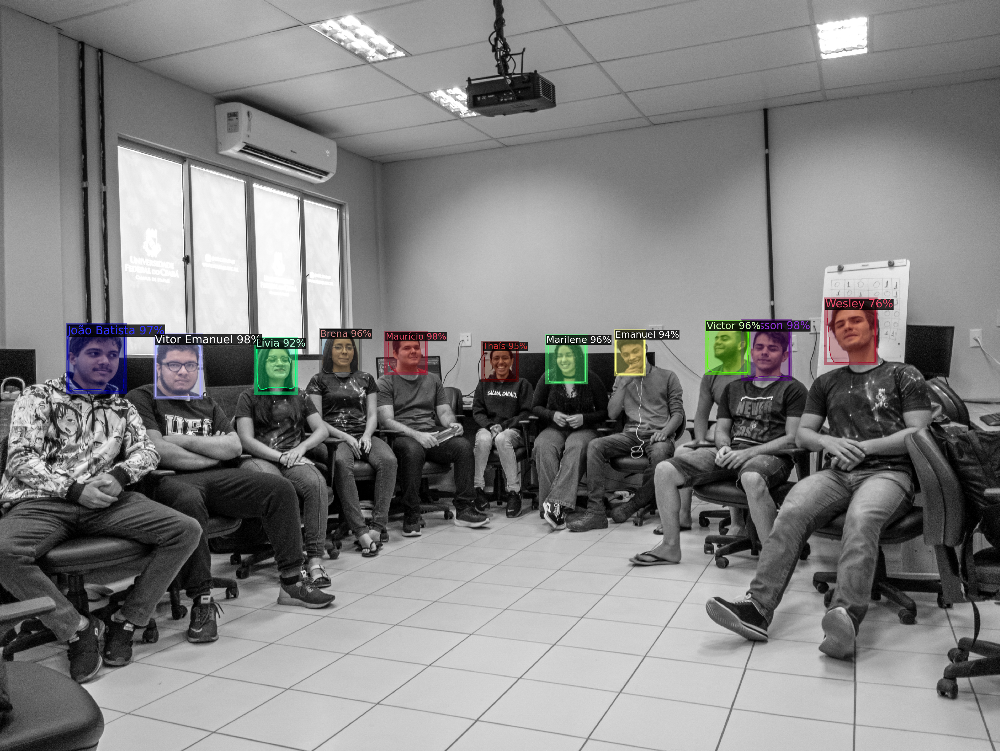

In [ ]:
# Selecionando uma amostra aleatória para visualizar o resultado da previsão.
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 1):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=fruits_nuts_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

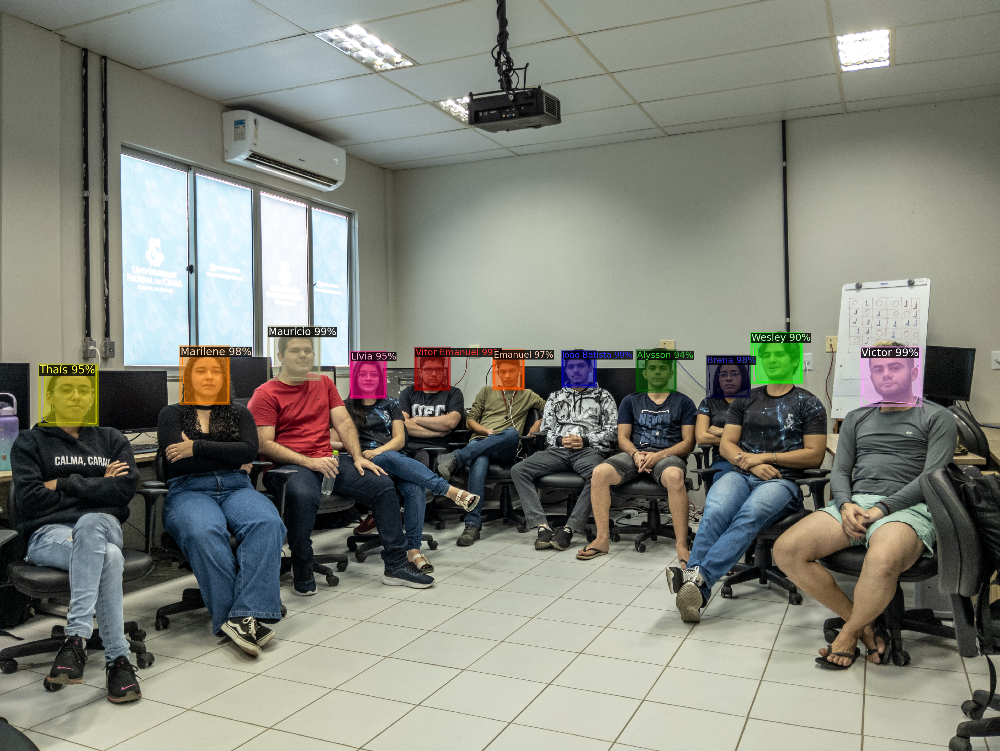

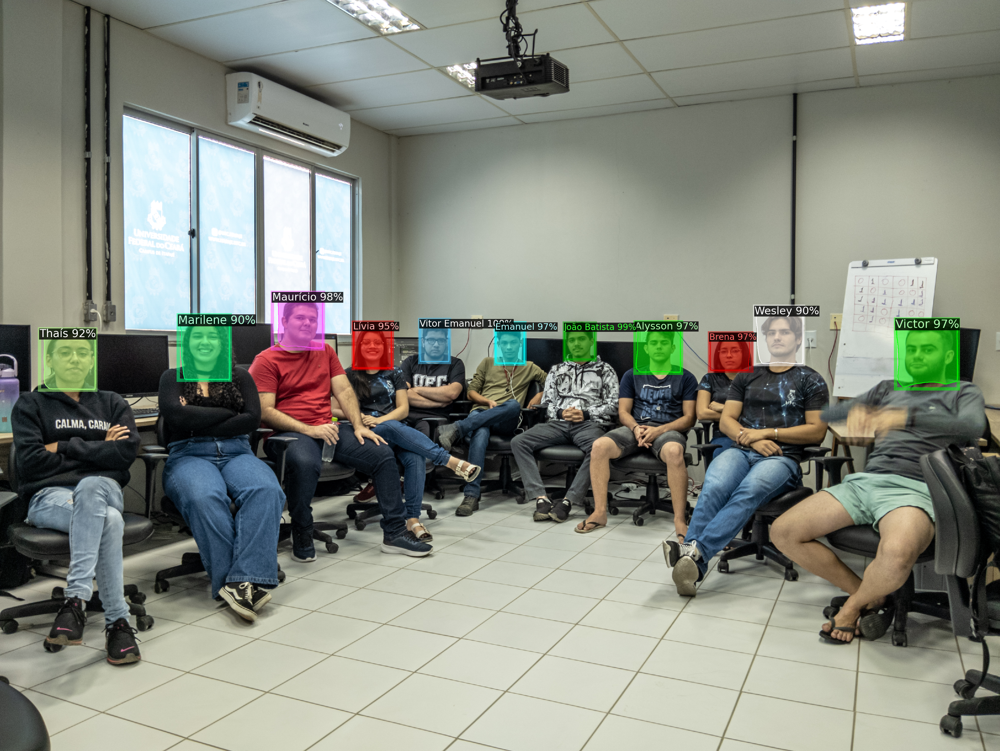

In [ ]:
# Realização de testes com 2 imagens que não foram adicionadas no dataset.
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('data-data/test/*'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=fruits_nuts_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

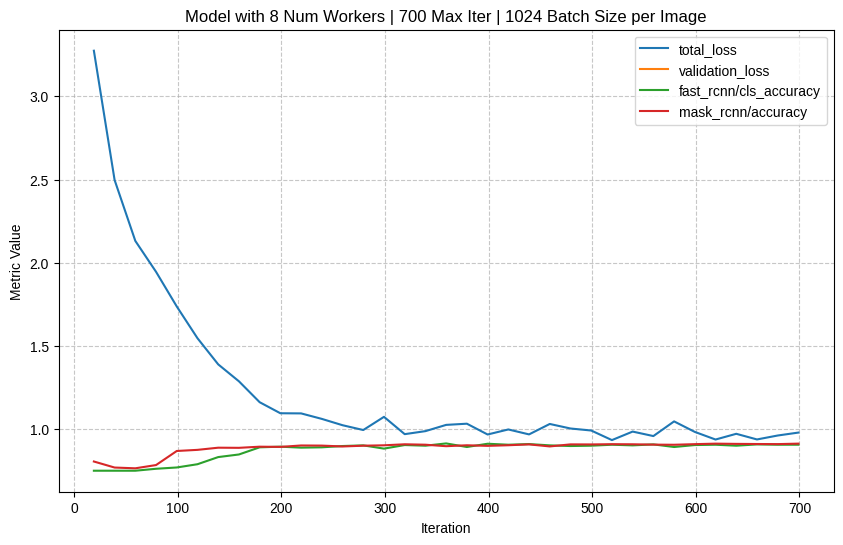

In [ ]:
# Traçando métricas obtidas do experimento.
import matplotlib.pyplot as plt
import json

experiment_folder = './output/'

def load_json_arr(json_path):
    lines = []
    with open(json_path, 'r') as f:
        for line in f:
            lines.append(json.loads(line))
    return lines

experiment_metrics = load_json_arr(experiment_folder + '/metrics.json')

plt.figure(figsize=(10, 6))

# Plot total loss
plt.plot(
   [x['iteration'] for x in experiment_metrics],
   [x['total_loss'] for x in experiment_metrics],
   label='total_loss', linestyle='-')

# Plot validation loss
plt.plot(
   [x['iteration'] for x in experiment_metrics if 'validation_loss' in x],
   [x['validation_loss'] for x in experiment_metrics if 'validation_loss' in x],
   label='validation_loss')

# Plot class accuracy
plt.plot(
   [x['iteration'] for x in experiment_metrics if 'fast_rcnn/cls_accuracy' in x],
   [x['fast_rcnn/cls_accuracy'] for x in experiment_metrics if 'fast_rcnn/cls_accuracy' in x],
   label='fast_rcnn/cls_accuracy')

# Plot mask accuracy
plt.plot(
   [x['iteration'] for x in experiment_metrics if 'mask_rcnn/accuracy' in x],
   [x['mask_rcnn/accuracy'] for x in experiment_metrics if 'mask_rcnn/accuracy' in x],
   label='mask_rcnn/accuracy')

plt.xlabel('Iteration')
plt.ylabel('Metric Value')
plt.title('Model with 8 Num Workers | 700 Max Iter | 1024 Batch Size per Image')

plt.legend()
plt.style.use('seaborn-v0_8-ticks')
plt.grid(True, linestyle='--', alpha=0.7)
plt.savefig('model.pdf')
plt.show()